<a href="https://colab.research.google.com/github/eduardoprospero/IC-ENEM/blob/main/ENEM_AE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Imports
import csv
import pandas as pd
from sklearn import metrics
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import zipfile

np.set_printoptions(suppress=True)

In [ ]:
#Liberar acesso ao drive
from google.colab import drive 
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
### CONHECENDO NOSSO BANCO DE DADOS ###
#Explorando tudo que tem dentro do arquivo
with zipfile.ZipFile('/content/drive/MyDrive/IC/microdados_enem_2019.zip') as z:
    print(*z.namelist(),sep="\n")

In [ ]:
#Chamando índices
with zipfile.ZipFile('/content/drive/MyDrive/IC/microdados_enem_2019.zip') as z:
    with z.open('DADOS/MICRODADOS_ENEM_2019.csv') as f:
        df = pd.read_csv(f,sep=';',encoding='ISO-8859-1', nrows=0)

----------------------------------
Dicionario:

https://uspbr-my.sharepoint.com/:x:/g/personal/juliecamolesi_usp_br/EfMqVG3fsiRMv0OxGhNWnwQByMLxx7-6zAPo4C0jAR1mMg?e=3hE0JI

-------------------------------------

In [ ]:
#Identificando índices
df.columns.values

In [ ]:
#Quantidade de índices
len(df.columns)

136

In [ ]:
#Selecionando índices que usaremos
columns=['NU_INSCRICAO', 'NU_IDADE', 'TP_SEXO',  'TP_COR_RACA', 'CO_MUNICIPIO_RESIDENCIA',
       'TP_ESCOLA', 'TP_ENSINO',                                              
       'IN_TREINEIRO',                                                          
       'CO_PROVA_CN', 'CO_PROVA_LC', 'CO_PROVA_CH', 'CO_PROVA_MT',                                               #cor da prova
       'TP_PRESENCA_CN','TP_PRESENCA_MT','TP_PRESENCA_LC','TP_PRESENCA_CH',                                         #presença por dia
       'TX_RESPOSTAS_CN', 'TX_RESPOSTAS_CH','TX_RESPOSTAS_LC', 'TX_RESPOSTAS_MT',   #vetor de respostas
       'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT',                      #nota por area
       'TP_LINGUA',                                                                 #ingles(0) ou espanhol(1)
       'TX_GABARITO_CN', 'TX_GABARITO_CH', 'TX_GABARITO_LC','TX_GABARITO_MT',       #vetor gabarito
       'NU_NOTA_REDACAO']       
len(columns)

30

----------------------------------------------

Areas de conhecimento:

-Primeiro dia:

LC= Linguagens, Códigos e suas Tecnologias.

CH = Ciências Humanas e suas Tecnologias.

-Segundo dia:

CN = Ciências da Natureza e suas Tecnologias.

MT= Matemática e suas Tecnologias.

----------------------------------------------

In [ ]:
#Abrindo apenas com os indices desejados
with zipfile.ZipFile('/content/drive/MyDrive/IC/microdados_enem_2019.zip') as z:
    with z.open('DADOS/MICRODADOS_ENEM_2019.csv') as f:
        df = pd.read_csv(f,sep=';',encoding='ISO-8859-1', usecols=columns, dtype=str)

In [ ]:
#Quantidade de observações
t=len(df)
t

5095270

In [ ]:
#Visualizando o dataframe
df

,NU_INSCRICAO,CO_MUNICIPIO_RESIDENCIA,NU_IDADE,TP_SEXO,TP_COR_RACA,TP_ESCOLA,TP_ENSINO,IN_TREINEIRO,TP_PRESENCA_CN,TP_PRESENCA_CH,TP_PRESENCA_LC,TP_PRESENCA_MT,CO_PROVA_CN,CO_PROVA_CH,CO_PROVA_LC,CO_PROVA_MT,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,TX_RESPOSTAS_CN,TX_RESPOSTAS_CH,TX_RESPOSTAS_LC,TX_RESPOSTAS_MT,TP_LINGUA,TX_GABARITO_CN,TX_GABARITO_CH,TX_GABARITO_LC,TX_GABARITO_MT,NU_NOTA_REDACAO
0,190001595656,3552205,36,M,3,1,NaN,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1,190001421546,2910800,23,M,1,1,1,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
2,190001133210,2304400,39,F,3,1,1,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN
3,190001199383,1721000,25,F,1,1,NaN,0,1,1,1,1,504,510,513,516,483.8,503.6,537.3,392,BACCEEBEECDBEDDAEECDEDEADEBBCDBCAACADEEACCBBD,AECEDADAABAADBAADAEBACBAECCDAEADCDBBECCEDABCD,99999AAABEBBCCBDCAEECADBACAADAECCCDCCBAEBDEEEA...,DDBBBBCDCCDCAECCBBECDAEBADCD..CABCCECAEBDBBDA,1,BEEAAEBEEBADEADDADAEABCEDDDBCBCBCCACBCDADCCEB,EEBCEEDBADBBCBABCCADCEBACDBBACCACACBEADBBADCB,ADBBEDCABAABBCBCDAAECDDDBAAAECADECDCEBDEEAECBD...,BEDEEEAADBEBACABCDBABECECACADCBDCCEDCDABECDDD,460
4,190001237802,3118601,22,F,1,1,1,0,1,1,1,1,504,510,513,516,513.6,575.5,570.7,677,EEBEDEEEEEBDCEEBEEEEABEEBEEBAEDEECECCDBCECEAE,EEDCCEDDBCBEABAAABADCEDABDBBCBDCCCCDAEDEDBDCB,ABBBE99999ABBCACCCAEEEDCCDADCCAEDEDDEEDBBDECBD...,CDEEEEEAEECBABABCDCACEEEEEEDEEACEAEDEBEEECEDE,0,BEEAAEBEEBADEADDADAEABCEDDDBCBCBCCACBCDADCCEB,EEBCEEDBADBBCBABCCADCEBACDBBACCACACBEADBBADCB,ADBBEDCABAABBCBCDAAECDDDBAAAECADECDCEBDEEAECBD...,BEDEEEAADBEBACABCDBABECECACADCBDCCEDCDABECDDD,860
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5095265,190006074437,5300108,41,F,3,1,NaN,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
5095266,190005429225,1302603,20,M,3,1,NaN,0,0,1,1,0,NaN,509,514,NaN,NaN,578.9,555.5,NaN,NaN,DAABAEACCBAEADBDCAEDBDEBCEBAECEBBDBBEEABCDADC,99999CABEABCCBCDBAEBBAADBECCEEAADBEEDDEACDCBCE...,NaN,1,NaN,ACACEEBCCBABADBBBACDBBACCCCADCEBADCBEEDBBEADB,EBBADCABDABACBCEBDEEAAADDBECDECDDBADBCDAAECBCC...,NaN,500
5095267,190006087652,4302105,21,M,0,1,NaN,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
5095268,190006087653,4302105,22,M,0,1,NaN,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN


In [ ]:
#### DADOS COMPLETOS ###
#Compareceram nas duas etapas (selecionando os q compareceram na segunda, pq se vc foi na segunda obrigatoriamente ce foi na primeira) - ERRADO, ARRUMAR
a=df[df['TP_PRESENCA_MT'] == '1']
print('Alunos que faltaram=',t-len(a),'(',(t-len(a))*100/t,'%)' )

#Treineiros
trei=df[df['IN_TREINEIRO']=='1']
print('São treineiros=',len(trei),'(',(len(trei))*100/t,'%)' )

#Nao sao treineiros e nao faltaram em nada
b=a[a['IN_TREINEIRO']=='0']
print('Compareceram nas duas etapas e não são treineiros=',len(b),'(',(len(b))*100/t,'%)' )

Alunos que faltaram= 1384837 ( 27.178873739762565 %)
São treineiros= 616668 ( 12.102754122941473 %)
Compareceram nas duas etapas e não são treineiros= 3179862 ( 62.40811576226579 %)


In [ ]:
#Identificando provas azuis
q=df[df['CO_PROVA_LC'] == '511']
print('Alunos com prova azul=',len(q),'(',(len(q))*100/t,'%)' )

#Identificando nao treineiros
ntrei=q[q['IN_TREINEIRO']=='0']
print('nao são treineiros=',len(trei),'(',(len(trei))*100/t,'%)' )

#Identificando presencas
w=ntrei[ntrei['TP_PRESENCA_MT'] == '1']
print('Alunos que n faltaram=',len(w),'(',(len(w))*100/t,'%)' )

Alunos com prova azul= 978170 ( 19.19760876263672 %)
nao são treineiros= 616668 ( 12.102754122941473 %)
Alunos que n faltaram= 790677 ( 15.517862645159138 %)


In [ ]:
#Selecionando as provas azuis

#Primeiro Dia
azulD1=b[b['CO_PROVA_LC'] == '511']
print('Compareceram nas duas etapas, não são treineiros e a prova do primeiro dia é azul=',len(azulD1),'(', (len(azulD1))*100/t,'%)' )

#Segundo Dia
azulD2=b[b['CO_PROVA_MT'] == '515']
print('Compareceram nas duas etapas, não são treineiros e a prova do segundo dia é azul=',len(azulD2),'(', (len(azulD2))*100/t,'%)' )

Compareceram nas duas etapas, não são treineiros e a prova do primeiro dia é azul= 790677 ( 15.517862645159138 %)
Compareceram nas duas etapas, não são treineiros e a prova do segundo dia é azul= 792216 ( 15.548067128925455 %)


In [ ]:
#Lingua escolhida
#1 = Espanhol ; 0 = Ingles
esp=azulD1[azulD1['TP_LINGUA']=="1"]
print('Escolheram espanhol=',len(esp),'(',(len(esp))*100/len(azulD1),'%)' )

Escolheram espanhol= 416983 ( 52.73746422369691 %)


In [ ]:
#Espanhol por tipo de ensino
duas = ['TP_LINGUA','TP_ESCOLA']
teste = azulD1.filter(items=duas)
testet=teste[teste['TP_LINGUA']=='1']
df_esp = testet.groupby('TP_ESCOLA').count()
df_esp

,TP_LINGUA
TP_ESCOLA,
1,276638
2,126637
3,13708


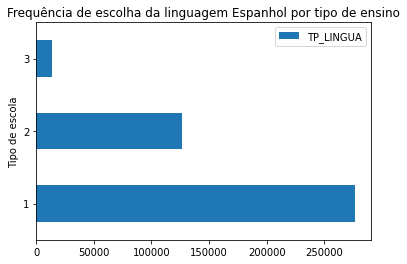

In [ ]:
#Visualização
df_esp.plot(title = "Frequência de escolha da linguagem Espanhol por tipo de ensino", xlabel = "Tipo de escola", ylabel = "Frequência de escolha da linguagem Espanhol", kind = 'barh')
plt.show()

In [ ]:
#Ingles por tipo de ensino
testet=teste[teste['TP_LINGUA']=='0']
df_ing = testet.groupby('TP_ESCOLA').count()
df_ing

,TP_LINGUA
TP_ESCOLA,
1,210584
2,125121
3,37989


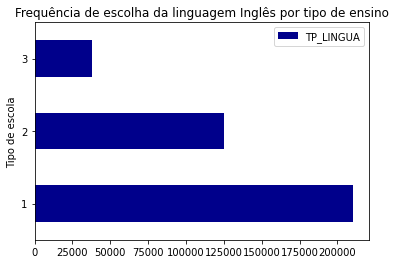

In [ ]:
#Visualização
df_ing.plot(title = "Frequência de escolha da linguagem Inglês por tipo de ensino", xlabel = "Tipo de escola", ylabel = "Frequência de escolha da linguagem Espanhol", kind = 'barh', color = "darkblue")
plt.show()

In [ ]:
#Separar num .CSV e salvar no drive
from google.colab import drive
drive.mount ('/drive')
df[df['CO_PROVA_LC']=='511'].to_csv('/drive/MyDrive/IC/amostra_d1.csv')
df[df['CO_PROVA_MT']=='515'].to_csv('/drive/MyDrive/IC/amostra_d2.csv')

Mounted at /drive


# COMEÇA AQUI!!!!!!!

In [ ]:
#Importando as amostras do drive
azulD1 = pd.read_csv("/content/drive/My Drive/IC/amostra_d1.csv")
azulD2 = pd.read_csv("/content/drive/My Drive/IC/amostra_d2.csv")
azulD1 = azulD1.drop(columns=['Unnamed: 0'])
azulD2 = azulD2.drop(columns=['Unnamed: 0'])

In [ ]:
azulD1.loc[[541175]]

,NU_INSCRICAO,CO_MUNICIPIO_RESIDENCIA,NU_IDADE,TP_SEXO,TP_COR_RACA,TP_ESCOLA,TP_ENSINO,IN_TREINEIRO,TP_PRESENCA_CN,TP_PRESENCA_CH,TP_PRESENCA_LC,TP_PRESENCA_MT,CO_PROVA_CN,CO_PROVA_CH,CO_PROVA_LC,CO_PROVA_MT,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,TX_RESPOSTAS_CN,TX_RESPOSTAS_CH,TX_RESPOSTAS_LC,TX_RESPOSTAS_MT,TP_LINGUA,TX_GABARITO_CN,TX_GABARITO_CH,TX_GABARITO_LC,TX_GABARITO_MT,NU_NOTA_REDACAO
541175,190003736298,2611606,19.0,M,3,1,NaN,0,1,1,1,1,505.0,507,511,518.0,417.1,315.9,563.0,613.9,ACEBBDCAEDACCDBEACBCDDBADEABAACCDACAEBCEABCCA,EE...........................................,99999BBCAEBACEEAEEECAAAECB.EAEECBCCDEEDADDCDDC...,DACBACCBDDBAEDDEBDEDABBCCADBEBADBCBBADEDCABDB,1,DADCCEBBCCACBEEBEEBACBCDDDDADBCBBCEAEADEADAAE,BACCCBABBADCBCEEEBCACACEEDBCCADBEADBADBBBACDB,BDABEABCADBCBAADDBECDAAECDAECBECBCCDEEAAADDBBC...,DBEBACABCDBABECEEEDCBDCCEDCDABEDAADDDECACAECB,0


 Temos 790677 ( 15.517862645159138 %) observações no primeiro dia e 792216 ( 15.548067128925455 %) no segundo


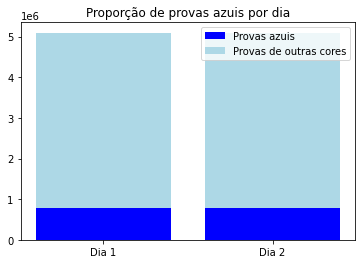

In [ ]:
##Provas azuis
#Análise
print(' Temos',len(azulD1),'(',len(azulD1)*100/5095270,'%) observações no primeiro dia e',len(azulD2),'(',len(azulD2)*100/5095270,'%) no segundo')

#Visualização
azuis = [len(azulD1), len(azulD2)]
sup = [5095270-len(azulD1), 5095270-(len(azulD2))]
dias = ["Dia 1", "Dia 2"]

plt.bar(dias, azuis, color = "blue")
plt.bar(dias, sup, color = "lightblue", bottom = azuis)
plt.ylabel('')
plt.title("Proporção de provas azuis por dia")
plt.legend(('Provas azuis', 'Provas de outras cores'))
plt.show()

São treineiros no primeiro dia= 140498 ( 14.363351973583324 %)
São treineiros no segundo dia= 132261 ( 14.306575501607936 %)


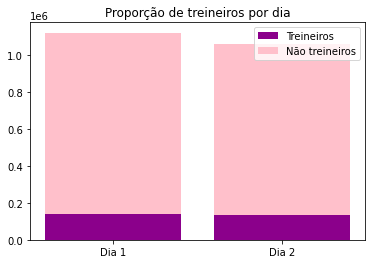

In [ ]:
##Treineiros
#Primeiro dia
trei=azulD1[azulD1['IN_TREINEIRO']==1]
print('São treineiros no primeiro dia=',len(trei),'(',(len(trei))*100/len(azulD1),'%)' )

trei2=azulD2[azulD2['IN_TREINEIRO']==1]
print('São treineiros no segundo dia=',len(trei2),'(',(len(trei2))*100/len(azulD2),'%)' )

#Visualização
treineiros = [len(trei), len(trei2)]
outros = [len(azulD1),len(azulD2)]
dias = ["Dia 1", "Dia 2"]

plt.bar(dias, treineiros, color = "darkmagenta")
plt.bar(dias, outros, color = "pink", bottom = treineiros)
plt.ylabel('')
plt.title("Proporção de treineiros por dia")
plt.legend(('Treineiros', 'Não treineiros'))
plt.show()

In [ ]:
##Gráficos bonitos e interativos 
#NÃO RODAR!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
!pip install -U plotly

     |████████████████████████████████| 23.9 MB 1.2 MB/s 
  Attempting uninstall: plotly
    Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


In [ ]:
pd.options.plotting.backend = "plotly"

In [ ]:
#Idade na primeira etapa da nossa amostra
azulD1.NU_IDADE.value_counts().sort_index().plot(kind='bar')

In [ ]:
#Idade na segunda etapa da nossa amostra
azulD2.NU_IDADE.value_counts().sort_index().plot(kind='bar')

In [ ]:
#Importando a posiçao geografica dos municipios pra fazer o grafico de mapa
with open('municipios.csv.txt', 'r') as in_file:
    stripped = (line.strip() for line in in_file)
    lines = (line.split(",") for line in stripped if line)
    with open('mun.csv', 'w') as out_file:
        writer = csv.writer(out_file)
        writer.writerows(lines)

In [ ]:
#Lendo o dataset e importando os codigos de municipio
municipios= pd.read_csv('mun.csv')
municipios["codigo_ibge"] = pd.to_numeric(municipios["codigo_ibge"])

In [ ]:
#TRANSFORMANDO OS VALORES EM NUMEROS
##MUITO IMPORTANTE!
azulD1['CO_MUNICIPIO_RESIDENCIA']=pd.to_numeric(azulD1['CO_MUNICIPIO_RESIDENCIA'])
azulD2['CO_MUNICIPIO_RESIDENCIA']=pd.to_numeric(azulD2['CO_MUNICIPIO_RESIDENCIA'])

In [ ]:
juntando= pd.merge(azulD1, municipios, 
                   how='left', left_on=['CO_MUNICIPIO_RESIDENCIA'],
                   right_on=['codigo_ibge'])
juntando2= pd.merge(azulD2, municipios, 
                   how='left', left_on=['CO_MUNICIPIO_RESIDENCIA'],
                   right_on=['codigo_ibge'])

In [ ]:
juntando["NU_NOTA_CN"] = pd.to_numeric(juntando["NU_NOTA_CN"])
juntando["NU_NOTA_CH"] = pd.to_numeric(juntando["NU_NOTA_CH"])
juntando2["NU_NOTA_LC"] = pd.to_numeric(juntando2["NU_NOTA_LC"])
juntando2["NU_NOTA_MT"] = pd.to_numeric(juntando2["NU_NOTA_MT"])

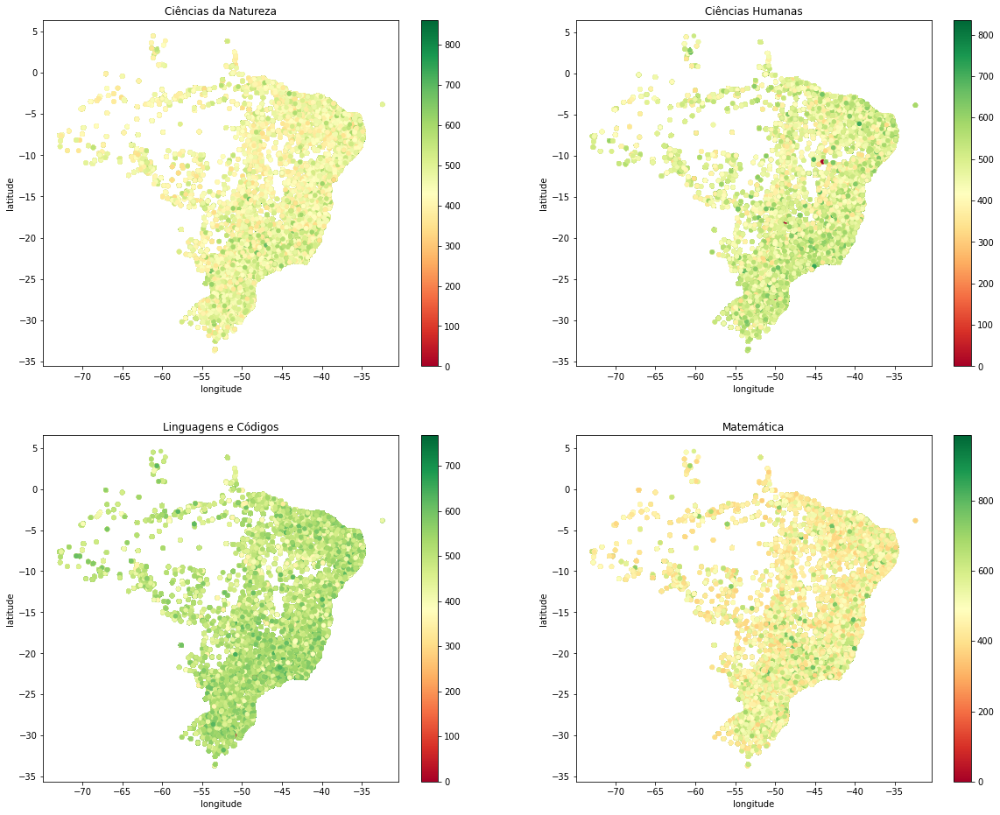

In [ ]:
#Grafico de desempenho no mapa brasileiro
fig, ax= plt.subplots(2,2, figsize=(20,16))
juntando.plot.scatter(y='latitude',x='longitude', 
                      c=juntando['NU_NOTA_CN'], 
                      cmap='RdYlGn',
                       title='Ciências da Natureza', ax=ax[0,0])
juntando.plot.scatter(y='latitude',x='longitude', 
                      c=juntando['NU_NOTA_CH'], 
                      cmap='RdYlGn',
                      title='Ciências Humanas', ax=ax[0,1])
juntando2.plot.scatter(y='latitude',x='longitude', 
                      c=juntando2['NU_NOTA_LC'], 
                      cmap='RdYlGn',
                      title='Linguagens e Códigos', ax=ax[1,0])
juntando2.plot.scatter(y='latitude',x='longitude', 
                      c=juntando2['NU_NOTA_MT'], 
                      cmap='RdYlGn',
                      title='Matemática', ax=ax[1,1])

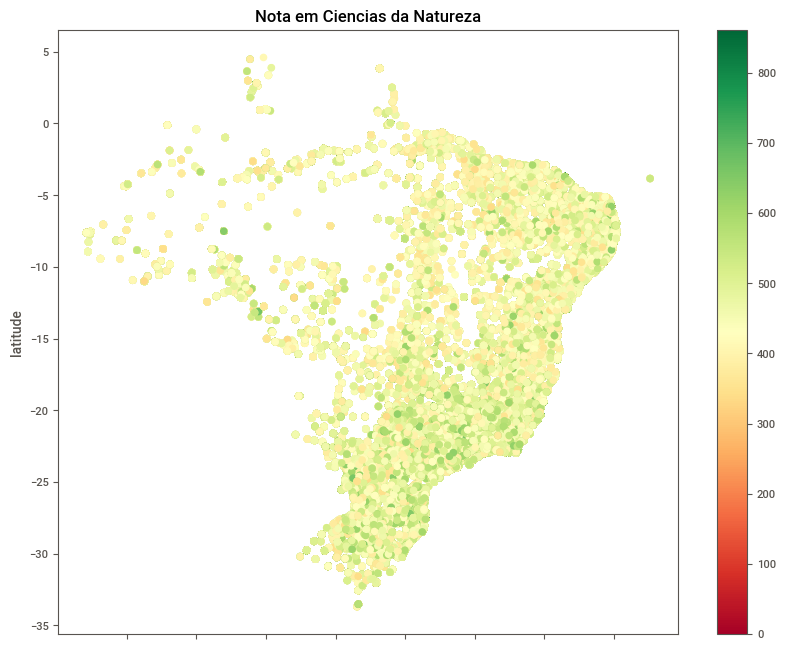

In [ ]:
juntando.plot.scatter(y='latitude',x='longitude', 
                      c=juntando['NU_NOTA_CN'], 
                      cmap='RdYlGn',
                      figsize=(10,8), title='Nota em Ciencias da Natureza')

In [ ]:
#Desempenho da redaçao por sexo
duas = ['TP_SEXO','NU_NOTA_REDACAO']
teste = azulD1.filter(items=duas)
teste.head()

,TP_SEXO,NU_NOTA_REDACAO
11,M,500
22,M,500
28,F,580
46,F,860
55,F,260


In [ ]:
#Quantas pessoas fizeram a prova azul por gênero
teste.groupby('TP_SEXO').count()

,NU_NOTA_REDACAO
TP_SEXO,
F,466348
M,324329


In [ ]:
#################################################
###LEMBRAR DE CONVERTER NUMEROS PARA INTEIRO#####
#################################################
teste["NU_NOTA_REDACAO"] = pd.to_numeric(teste["NU_NOTA_REDACAO"])

In [ ]:
#Funçao pra descrição
teste.groupby('TP_SEXO').describe()

NU_NOTA_REDACAO                          ...                      
                  count        mean         std  ...    50%    75%     max
TP_SEXO                                          ...                      
F              466348.0  586.083225  182.074259  ...  580.0  680.0  1000.0
M              324329.0  571.163911  182.965763  ...  580.0  680.0  1000.0

[2 rows x 8 columns]

TP_SEXO
F    [[AxesSubplot(0.125,0.125;0.775x0.755)]]
M    [[AxesSubplot(0.125,0.125;0.775x0.755)]]
dtype: object

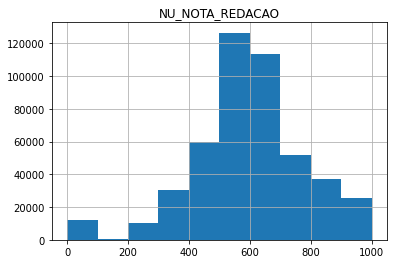

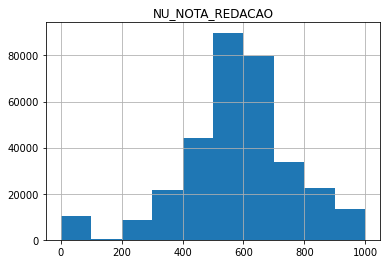

In [ ]:
#Histograma da nota na redaçao por sexo
teste.groupby('TP_SEXO').hist()

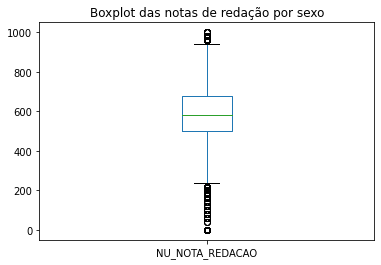

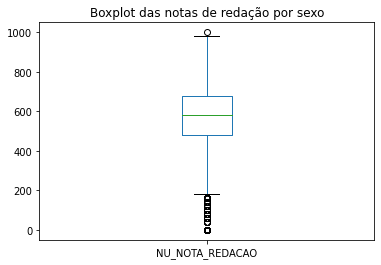

In [ ]:
#Boxplot das notas de redação por sexo
grupo = teste.groupby('TP_SEXO')
grupo.plot(kind = "box", title = "Boxplot das notas de redação por sexo")
plt.show()

In [ ]:
#Analise exploratoria automatizada

In [ ]:
!pip install pandas-profiling==2.8.0

In [ ]:
from pandas_profiling import profile_report

In [ ]:
azulD1.profile_report()

Summarize dataset:   0%|          | 0/45 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
azulD2.profile_report()

Summarize dataset:   0%|          | 0/45 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
!pip install sweetviz

In [ ]:
#Import sweetviz library
import sweetviz as xx

In [ ]:
#Analisando os dados do banco azul segundo dia
study_report = xx.analyze(azulD1)

                                             |          | [  0%]   00:00 -> (? left)

In [ ]:
#Gerar relatório
study_report.show_html('Dados_banco_azulD1.html')

Report Dados_banco_azul1.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [ ]:
#Analisando os dados do banco azul primeiro dia
study_report = xx.analyze(azulD2)

                                             |          | [  0%]   00:00 -> (? left)

In [ ]:
#Gerar relatório
study_report.show_html('Dados_banco_azulD2.html')

Report Dados_banco_azul2.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


# Aqui começa analise de TRI

In [ ]:
###########################
#Lembrar que tem separaçao ingles espanhol

Respostas:

\* dupla marcação

. em branco

9 item não apresentado

In [ ]:
####Ciencias Humanas
matriz = []

for i in azulD1['TX_RESPOSTAS_CH']:
    matriz.append(list(i))

pd.DataFrame(matriz).to_csv('/content/drive/My Drive/IC/CH.csv')

In [ ]:
#Chamando o csv
prova_CH = pd.read_csv("/content/drive/My Drive/IC/CH.csv")
prova_CH=prova_CH.drop(columns=['Unnamed: 0'])
#Selecionando o gabarito
gabarito_CH=list(azulD1['TX_GABARITO_CH'][0])

In [ ]:
prova_CH

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44
0,D,C,E,A,B,D,A,E,C,B,A,D,B,C,A,D,B,C,D,A,E,B,A,D,C,E,D,B,A,C,B,C,C,D,B,A,A,B,E,D,B,C,B,D,A
1,A,E,B,C,A,B,A,A,C,B,D,C,E,D,E,E,E,A,E,D,C,E,C,B,E,D,B,C,A,A,B,C,A,E,D,E,A,C,B,E,B,A,A,B,D
2,E,E,A,E,D,E,B,C,E,B,D,D,B,C,A,A,A,B,C,C,C,D,D,E,B,D,B,B,A,A,C,B,E,D,C,B,A,B,A,A,E,D,C,C,E
3,B,A,D,C,C,B,A,B,A,B,A,E,C,C,D,A,B,E,C,A,E,E,D,C,D,E,C,D,B,A,B,A,A,E,B,A,D,A,C,E,A,C,B,E,E
4,B,C,C,B,C,B,A,B,D,A,D,D,B,C,E,E,A,A,C,C,C,B,C,E,D,E,B,E,A,A,E,B,E,A,D,B,A,D,B,E,E,A,C,C,B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
978165,C,A,A,C,A,B,A,D,A,B,B,B,D,D,D,C,B,C,C,A,C,E,C,C,E,C,A,E,C,D,B,E,A,E,E,E,A,D,C,C,B,A,C,C,B
978166,D,C,E,A,A,B,A,B,A,B,D,E,E,C,A,A,E,A,C,D,C,B,D,C,E,A,D,A,B,D,B,C,B,E,C,E,D,D,B,E,E,D,C,C,B
978167,D,D,C,A,D,A,B,B,C,A,D,B,B,E,B,E,D,C,D,C,D,A,B,B,E,D,C,E,B,E,B,A,C,D,E,D,A,B,E,A,C,D,B,A,E
978168,B,E,C,C,A,D,A,E,B,A,E,C,E,D,B,B,C,D,B,A,C,E,B,C,D,A,E,D,B,E,B,C,A,E,B,B,D,B,A,B,D,A,E,B,A


In [ ]:
data = (prova_CH == gabarito_CH)
data

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44
0,False,False,False,False,False,False,True,False,False,False,False,False,True,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,True,False
1,False,False,False,True,False,True,True,False,False,False,True,True,False,False,True,True,True,False,False,False,True,False,True,False,True,True,True,True,False,True,False,False,False,False,True,False,True,False,True,False,True,True,False,False,False
2,False,False,False,False,False,False,False,False,False,False,True,False,True,True,False,False,False,True,True,False,True,False,False,True,False,True,True,False,False,True,False,True,True,False,False,True,True,False,False,False,False,False,True,False,False
3,True,True,False,True,True,True,True,True,False,False,False,False,False,True,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,True,False,True,False,True,True,True,True,False,True,True,False,True,True,True,True,False,False,True,False,True,False,True,True,False,False,True,False,False,True,False,True,True,True,True,True,True,True,True,False,False,True,True,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
978165,False,True,False,True,False,True,True,False,False,False,False,False,False,False,False,False,False,False,True,True,True,False,True,False,True,False,False,False,True,False,False,False,False,False,False,False,True,True,False,False,True,True,True,False,True
978166,False,False,False,False,False,True,True,True,False,False,True,False,False,True,False,False,True,False,True,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,True,False,True
978167,False,False,True,False,False,False,False,True,False,True,True,False,True,False,False,True,False,False,False,False,False,True,False,False,True,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False
978168,True,False,True,True,False,False,True,False,True,True,False,True,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,True,False,False,False


In [ ]:
data.loc[[541175]]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44
541175,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [ ]:
#O girth trabalha com alunos em colunas
data = data.to_numpy().transpose()

print(data.shape)

(45, 978170)


In [ ]:
data

array([[False, False, False, ..., False,  True, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ...,  True,  True, False],
       ...,
       [False, False,  True, ..., False, False, False],
       [ True, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

#Modelo de Rasch

In [ ]:
!pip install girth==0.3.6

  Created wheel for girth: filename=girth-0.3.6-py3-none-any.whl size=39584 sha256=5dcf17a839ca8129f42f04de65915f691f42c3c6f8d40fd0242cbfcdb21b440b
  Stored in directory: /root/.cache/pip/wheels/4a/f2/0f/2ea772d80f2b85c04417770e8896c9ed2202d818d2b20b1f44
Successfully built girth


In [ ]:
from girth import onepl_mml

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


In [ ]:
estimates = onepl_mml(data)

b_hat = estimates['Difficulty']

In [ ]:
#Funçao pra achar a posiçao do maior e do menor valor de b_hat
def indice_maior(L, fim):
    """ (list, n) -> int
        Devolve a posição do maior elemento da lista L
        encontrado entre as posições 0 e fim da lista.
    """
    imax = 0
    for i in range(1,fim):
        if L[i] > L[imax]:
            imax = i
            
    return imax
def indice_menor(L, fim):
    """ (list, n) -> int
        Devolve a posição do maior elemento da lista L
        encontrado entre as posições 0 e fim da lista.
    """
    imin = 0
    for i in range(1,fim):
        if L[i] < L[imin]:
            imin = i
            
    return imin    

In [ ]:
print('Questão mais facil:',45+indice_menor(b_hat,len(b_hat)))
print('Questao mais dificil:',45+indice_maior(b_hat,len(b_hat)))

Questão mais facil: 51
Questao mais dificil: 49


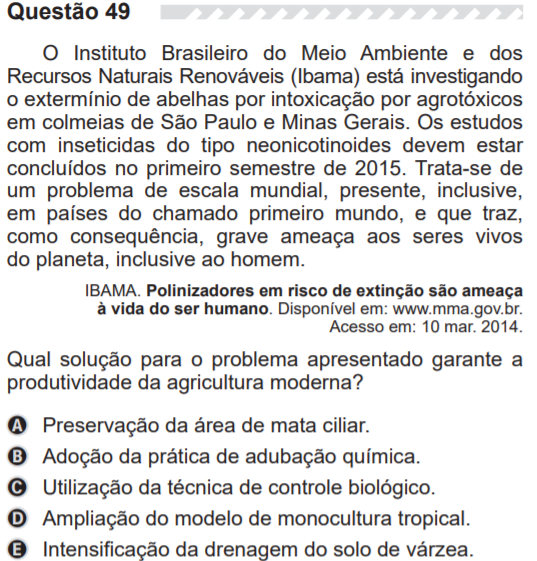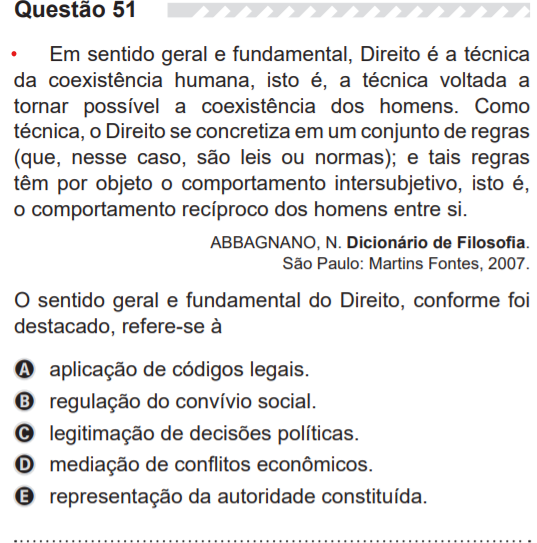

In [ ]:
##tentar com plotly
####tirar legenda
def plot_1pl(b, overlay = True, nrows=0, ncols=0):
    L = len(b)

    if(overlay):
        for j in range(L):
            theta = np.arange(-7, 7, 0.1)
            u = 1/(1+np.exp(-(theta-b[j])))
            plt.plot(theta, u, label=str(j+1))
        plt.legend(loc="lower right", fontsize=7, title="Questão")
    else:
        fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(12,12))
        i = 0
        for j in range(L):
            if(j%ncols == 0 and j > 0):
                i += 1

            theta = np.arange(-7, 7, 0.1)
            u = 1/(1+np.exp(-(theta-b[i])))
            ax[i,j%ncols].plot(theta, u)
            ax[i,j%ncols].set_title("Questão "+str(j+1))
        plt.subplots_adjust(hspace=0.5)
        fig.delaxes(ax[nrows-1,-1])
    

In [ ]:
import plotly.graph_objects as go

In [ ]:
L = len(b_hat)
fig = go.Figure() 

# if(overlay):
for j in range(L):
            theta = np.arange(-7, 7, 0.1)
            u = 1/(1+np.exp(-(theta-b_hat[j])))
            fig.add_trace(go.Scatter(x = theta, y = u))
fig.show()
            # plt.plot(theta, u, label=str(j+1))
      # plt.legend(loc="lower right", fontsize=7, title="Questão")
# else:
#         fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(12,12))
#         i = 0
#         for j in range(L):
#             if(j%ncols == 0 and j > 0):
#                 i += 1

#             theta = np.arange(-7, 7, 0.1)
#             u = 1/(1+np.exp(-(theta-b_hat[i])))
#             ax[i,j%ncols].plot(theta, u)
#             ax[i,j%ncols].set_title("Questão "+str(j+1))
#         plt.subplots_adjust(hspace=0.5)
#         fig.delaxes(ax[nrows-1,-1])

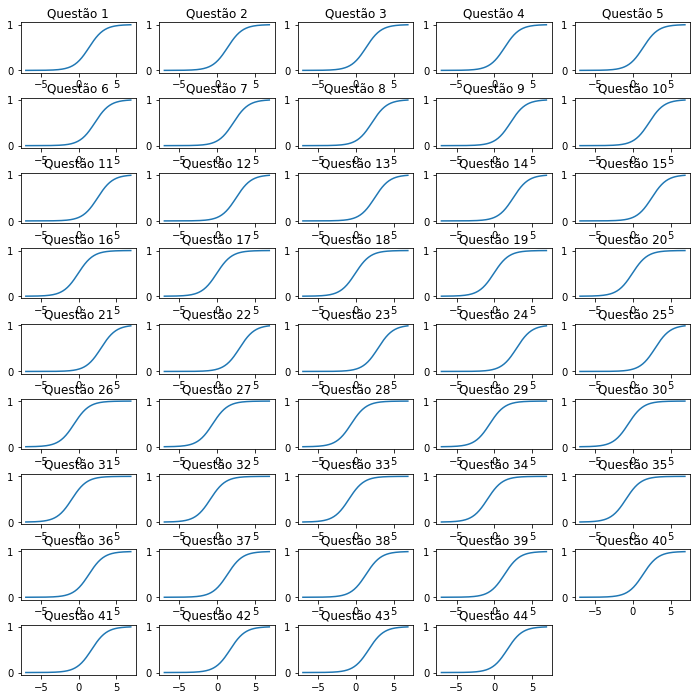

In [ ]:

plot_1pl(b_hat, overlay=False, nrows=9, ncols=5)

In [ ]:
##Linguagem e codigo
matriz12 = []

for i in d1['TX_RESPOSTAS_LC']:
    matriz12.append(list(i))

pd.DataFrame(matriz12).to_csv('/content/drive/My Drive/IC/LC.csv')

In [ ]:
prova_LC = pd.read_csv("/content/drive/My Drive/IC/LC.csv")
prova_LC=prova_LC.drop(columns=['Unnamed: 0'])
gabarito_LC=list(azulD1['TX_GABARITO_LC'][0])

In [ ]:
data12 = (prova_LC == gabarito_LC)
data12 = data12.to_numpy().transpose()

In [ ]:
estimates = onepl_mml(data12)

b_hat12 = estimates['Difficulty']
b_hat12

array([ 1.35537632,  1.68087514,  1.08312738,  0.98403154,  1.64085111,
        3.1598592 ,  1.89970363,  3.20072993,  2.33932707,  2.57161183,
        0.93722607, -0.74541556, -0.84702251,  0.57062068,  1.41321249,
        0.7419148 , -0.15523481,  1.22309519,  1.16506369,  1.27393701,
       -0.18047309, -1.09693247,  0.95635687, -2.38793257, -0.4092749 ,
        2.00449318,  1.58900057, -0.45814745,  1.09578243,  2.08589441,
        1.37002677, -1.20753427,  1.96049188,  0.48034742,  0.12670105,
        1.42775567, -0.28730689,  3.90217574,  1.26372281, -1.46858626,
        0.35337756, -1.95766137,  1.73494561,  1.61670764,  0.66763784,
        0.84932361,  2.67680771,  0.23270859,  2.77516635,  2.19889538])

In [ ]:
print('Questão mais facil:',indice_menor(b_hat12,len(b_hat12))-5)
print('Questao mais dificil:',indice_maior(b_hat12,len(b_hat12)-5))

Questão mais facil: 18
Questao mais dificil: 37


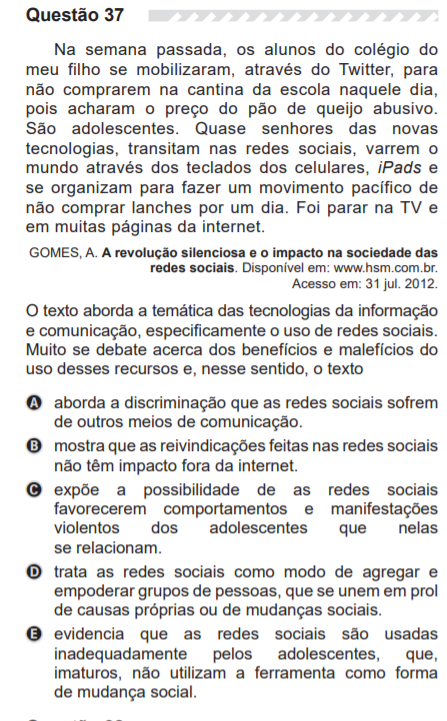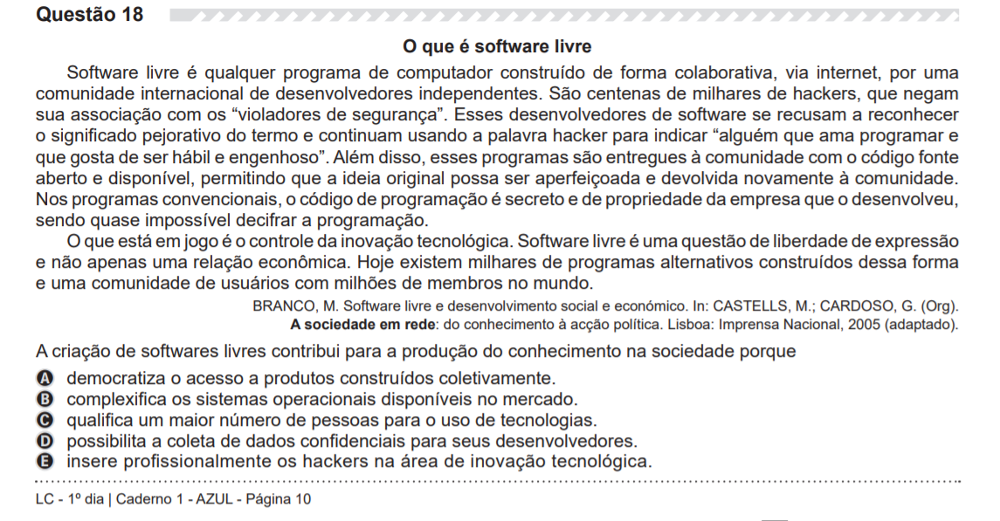

In [ ]:
L = len(b_hat12)
fig = go.Figure() 

# if(overlay):
for j in range(L):
            theta = np.arange(-7, 7, 0.1)
            u = 1/(1+np.exp(-(theta-b_hat12[j])))
            fig.add_trace(go.Scatter(x = theta, y = u))
fig.show()

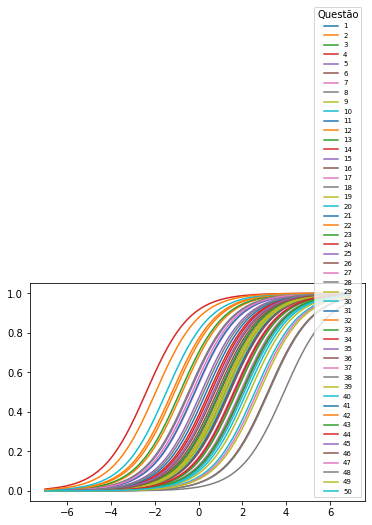

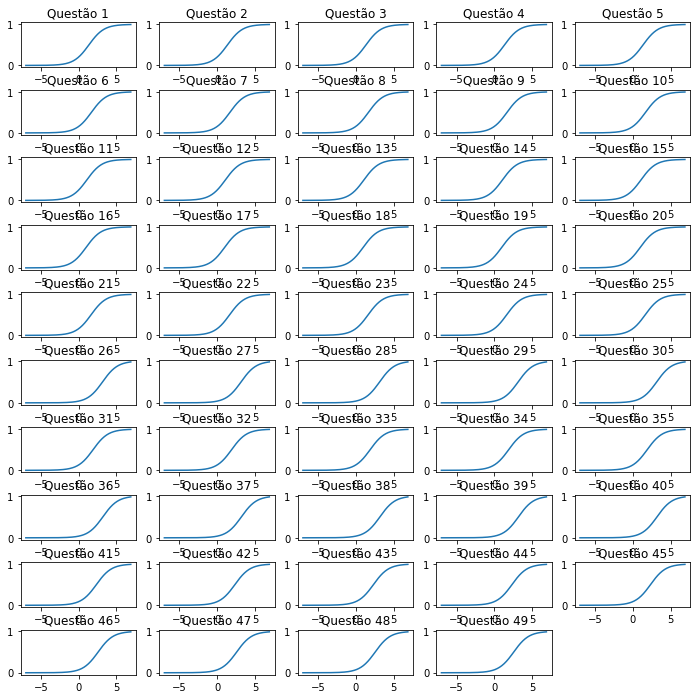

In [ ]:
plot_1pl(b_hat12)
plot_1pl(b_hat12, overlay=False, nrows=10, ncols=5)

In [ ]:
#### Segundo dia
Resp2=['NU_INSCRICAO','TX_RESPOSTAS_CN','TX_RESPOSTAS_MT','TX_GABARITO_CN','TX_GABARITO_MT']
d2 = azulD2.filter(items=Resp2)
gabarito_CN=list(d2['TX_GABARITO_CN'][0])
gabarito_MT=list(d2['TX_GABARITO_MT'][0])

In [ ]:
#### Ciencias Naturais
matriz21 = []

for i in d2['TX_RESPOSTAS_CN']:
    matriz21.append(list(i))

pd.DataFrame(matriz21).to_csv('/content/drive/My Drive/IC/CN.csv')

In [ ]:
prova_CN = pd.read_csv("/content/drive/My Drive/IC/CN.csv")
prova_CN=prova_CN.drop(columns=['Unnamed: 0'])

In [ ]:
prova_CN

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44
0,C,E,E,E,E,C,C,C,D,B,B,E,A,D,B,C,D,B,C,B,A,A,D,E,D,B,A,E,B,A,B,E,E,B,B,E,A,C,B,D,A,E,D,B,D
1,B,D,C,B,D,B,D,E,C,C,C,B,D,B,B,D,D,C,E,B,B,C,D,D,B,B,D,E,D,D,B,B,B,B,B,C,D,C,D,D,C,B,B,A,C
2,A,E,D,C,D,C,B,D,E,B,C,C,C,B,A,B,C,C,E,B,B,B,C,E,C,B,D,D,E,B,B,A,A,B,C,B,D,C,B,D,C,B,D,B,A
3,C,E,E,D,B,C,D,*,E,*,B,A,C,E,C,D,D,A,A,C,C,*,*,D,D,B,B,E,B,C,B,E,C,C,A,C,C,E,B,A,D,D,B,A,B
4,D,C,E,B,D,A,E,C,C,B,D,D,C,D,A,A,B,D,E,C,E,B,C,D,B,E,E,D,A,A,A,C,E,D,D,D,A,C,B,E,A,B,A,B,C
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
924472,C,D,D,E,E,C,C,E,D,D,D,B,C,A,A,A,B,C,B,D,B,A,E,D,D,A,B,E,C,C,E,E,E,A,B,D,D,C,B,C,C,A,D,E,B
924473,C,D,E,A,D,C,D,E,D,E,B,C,B,D,D,B,D,C,C,E,C,A,A,B,A,D,D,E,A,E,C,E,A,C,A,D,B,C,E,D,C,E,A,C,C
924474,A,C,D,A,D,E,A,E,B,A,C,B,E,C,D,B,E,B,E,A,B,D,E,D,E,B,C,C,A,D,E,D,A,C,D,B,D,C,A,E,A,E,A,B,C
924475,D,B,E,E,D,B,E,A,A,E,B,D,A,C,A,A,B,C,D,B,B,A,C,D,E,E,A,E,E,A,*,C,B,A,B,D,D,A,B,C,E,A,A,A,B


In [ ]:
data21 = (prova_CN == gabarito_CN)
data21 = data21.to_numpy().transpose()

In [ ]:
estimates = onepl_mml(data21)

b_hat21 = estimates['Difficulty']

In [ ]:
print('Questão mais facil:',90+indice_menor(b_hat21,len(b_hat21)))
print('Questao mais dificil:',90+indice_maior(b_hat21,len(b_hat21)))

Questão mais facil: 92
Questao mais dificil: 109


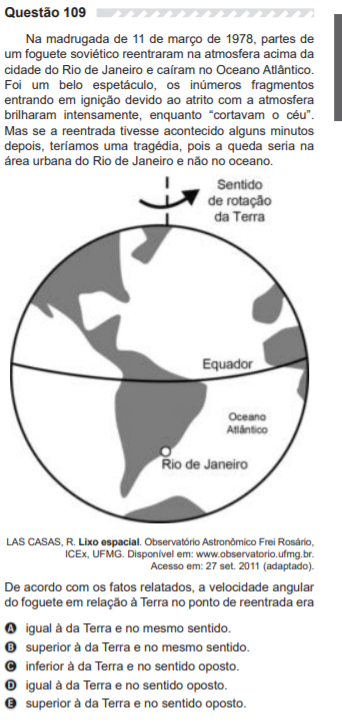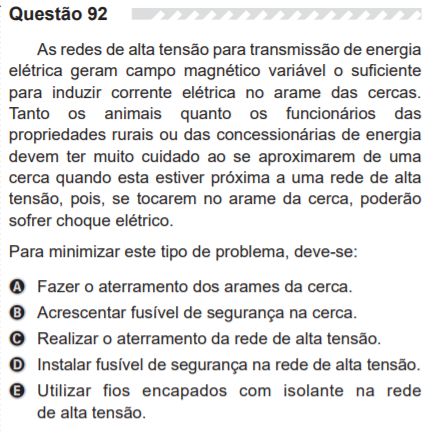

In [ ]:
L = len(b_hat21)
fig = go.Figure() 

# if(overlay):
for j in range(L):
            theta = np.arange(-7, 7, 0.1)
            u = 1/(1+np.exp(-(theta-b_hat21[j])))
            fig.add_trace(go.Scatter(x = theta, y = u))
fig.show()

IndexError: ignored

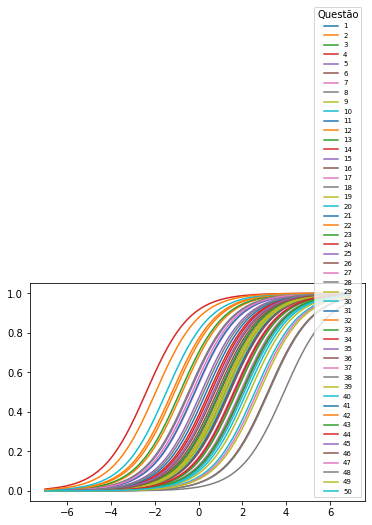

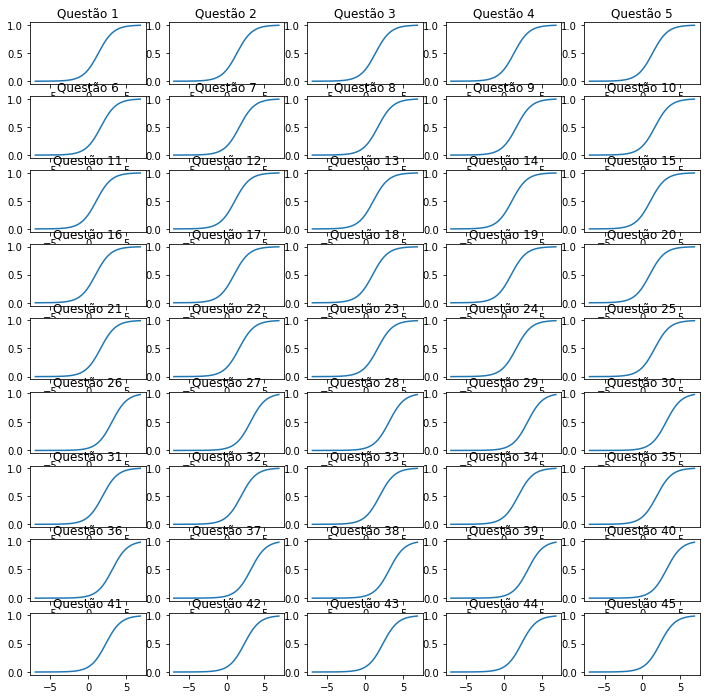

In [ ]:
plot_1pl(b_hat21)
plot_1pl(b_hat21, overlay=False, nrows=9, ncols=5)

In [ ]:
#### Matematica
matriz22 = []

for i in d2['TX_RESPOSTAS_MT']:
    matriz22.append(list(i))

pd.DataFrame(matriz22).to_csv('/content/drive/My Drive/IC/MT.csv')

In [ ]:
prova_MT = pd.read_csv("/content/drive/My Drive/IC/MT.csv")
prova_MT=prova_MT.drop(columns=['Unnamed: 0'])

In [ ]:
data22 = (prova_MT == gabarito_MT)
data22 = data22.to_numpy().transpose()

In [ ]:
estimates = onepl_mml(data22)

b_hat22 = estimates['Difficulty']

In [ ]:
print('Questão mais facil:',indice_menor(b_hat22,len(b_hat22)))
print('Questao mais dificil:',indice_maior(b_hat22,len(b_hat22)))

Questão mais facil: 8
Questao mais dificil: 32


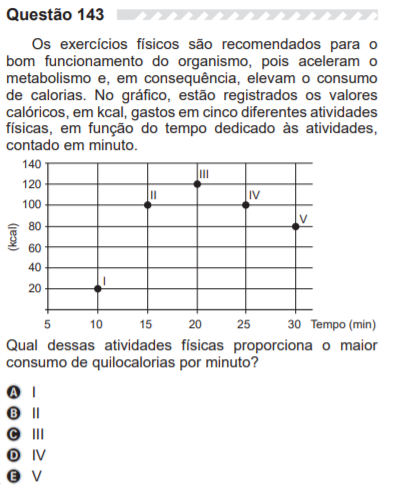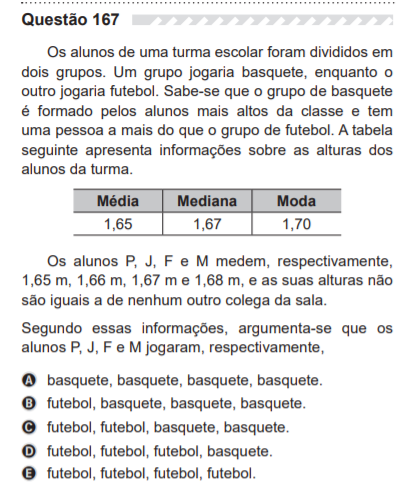

In [ ]:
L = len(b_hat22)
fig = go.Figure() 

# if(overlay):
for j in range(L):
            theta = np.arange(-7, 7, 0.1)
            u = 1/(1+np.exp(-(theta-b_hat22[j])))
            fig.add_trace(go.Scatter(x = theta, y = u))
fig.show()

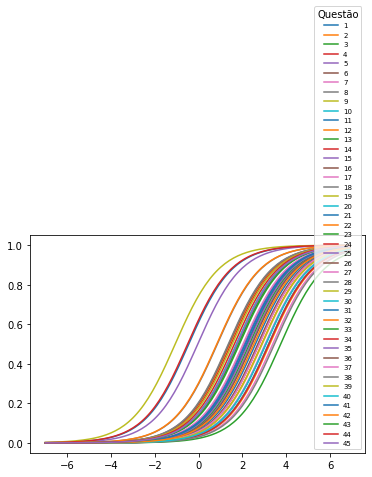

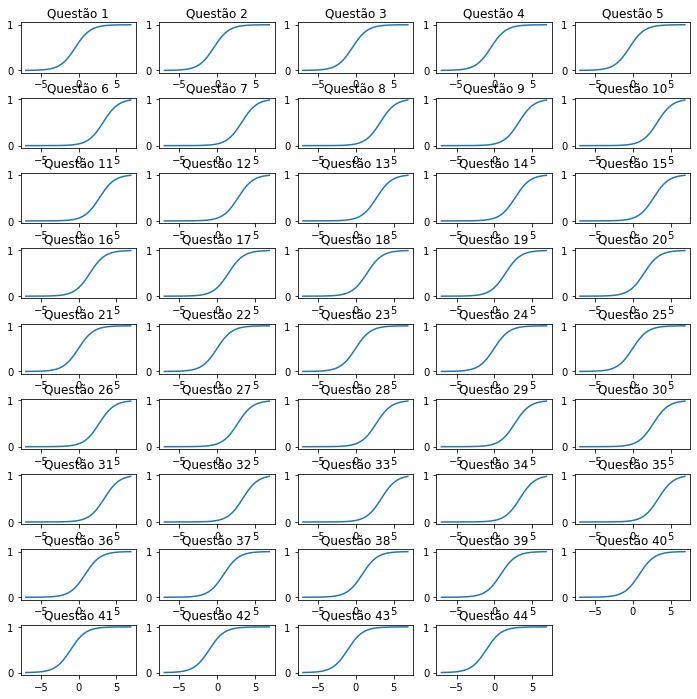

In [ ]:
plot_1pl(b_hat22)
plot_1pl(b_hat22, overlay=False, nrows=9, ncols=5)

In [ ]:
from girth import twopl_mml

In [ ]:
estimates = twopl_mml(data22)

a_hat = estimates['Discrimination']
b_hat = estimates['Difficulty']

print(a_hat)
print(b_hat)

[0.91171429 0.39407604 1.44908979 1.5238077  1.16171357 0.26194464
 0.78746531 1.83004853 0.73615912 0.28190567 0.27535234 0.61973551
 0.65571127 1.08336121 0.71710703 0.86376264 0.27649475 1.33289071
 0.25000475 0.50401718 0.25000475 0.26153831 0.25000475 0.29178082
 1.22708795 0.59318301 0.60872805 0.25000475 0.46842678 1.00449862
 1.03087662 0.26802499 0.34049711 1.10291986 0.50491694 0.6341453
 0.44716986 0.31438923 1.0048825  0.27256047 0.31746662 0.25000475
 0.46007585 0.78183634 1.11456216]
[-0.30843522  4.58585515  1.38630107  0.73193938 -0.02145898  5.63376129
  2.58584096  0.38975479 -0.86557637  5.99995275  5.99994433  1.32623531
  1.66292146 -0.3040973   1.97566491  0.99128659  5.99996651  0.72543944
  3.33597523  2.00085883  5.65328317  5.99986972  5.04217295  5.99995859
  1.16390835  2.37408257  1.92744587  5.99995123  2.66442474  1.10252238
  1.33532306  1.68574227  5.99994169  1.32761704  2.52980657  2.50010322
  3.46359669  5.99994569  1.84583301  5.99995634  3.7682792

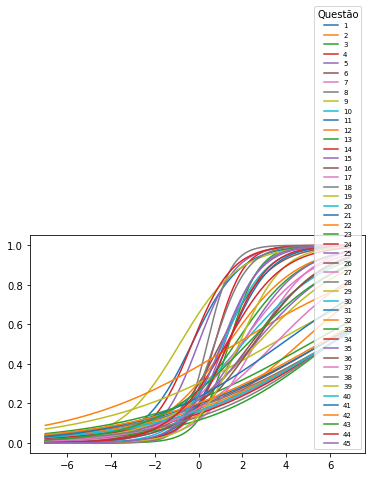

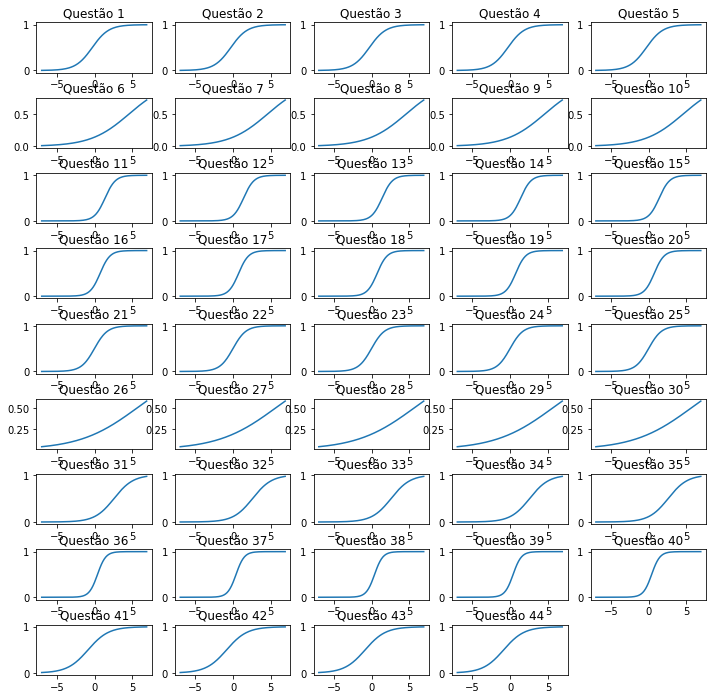

In [ ]:
def plot_2pl(a, b, overlay = True, nrows=0, ncols=0):
    L = len(a)

    if(overlay):
        for j in range(L):
            theta = np.arange(-7, 7, 0.1)
            u = 1/(1+np.exp(-a[j]*(theta-b[j])))
            plt.plot(theta, u, label=str(j+1))
        plt.legend(loc="lower right", fontsize=7, title="Questão")
    else:
        fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(12,12))
        i = 0
        for j in range(L):
            if(j%ncols == 0 and j > 0):
                i += 1

            theta = np.arange(-7, 7, 0.1)
            u = 1/(1+np.exp(-a[i]*(theta-b[i])))
            ax[i,j%ncols].plot(theta, u)
            ax[i,j%ncols].set_title("Questão "+str(j+1))
        plt.subplots_adjust(hspace=0.5)
        fig.delaxes(ax[nrows-1,-1])
    
plot_2pl(a_hat, b_hat)
plot_2pl(a_hat, b_hat, overlay=False, nrows=9, ncols=5)

In [ ]:
#Comparando nota com percentual de acerto
#CH
prova_CH = pd.read_csv("/content/drive/My Drive/IC/CH.csv")
prova_CH=prova_CH.drop(columns=['Unnamed: 0'])
gabarito_CH=list(azulD1['TX_GABARITO_CH'][0])
data = (prova_CH == gabarito_CH)

In [ ]:
nota_ch = azulD1.filter(['NU_NOTA_CH'])
nota_ch

,NU_NOTA_CH
0,351.7
1,568.9
2,466.8
3,457.9
4,622.1
...,...
978165,527.2
978166,509.5
978167,412.7
978168,427.3


In [ ]:
x=pd.DataFrame(data.sum(axis=1))
x.drop(1)
# x.index.name = 'n','Quant de acertos'
x

,0
"(n, Quant de acertos)",
0,7
1,20
2,15
3,11
4,29
...,...
978165,16
978166,13
978167,10


In [ ]:
df = pd.merge(nota_ch, x,how='outer')
df

MergeError: ignored

In [ ]:
df= pd.concat([nota_ch, x])
df

,NU_NOTA_CH,0
0,351.7,NaN
1,568.9,NaN
2,466.8,NaN
3,457.9,NaN
4,622.1,NaN
...,...,...
978165,NaN,16.0
978166,NaN,13.0
978167,NaN,10.0
978168,NaN,12.0
